# Домашнее задание

1) В этой домашней работе вам предстоит решить задачу сегментации объект/фон на датасете PascalVoc2012. . Это такая же задача, как мы решали на семинаре, поэтому пользуйтесь наработками и рекомендациями

2) необходимо дополнить список аугментаций (>= 2) : https://pytorch.org/vision/master/transforms.html , https://albumentations.ai

3) Добавить понятные метрики на валидацию mean-IoU

4) Добавить лосс Jaccard loss или DICE loss к BCE: https://arxiv.org/pdf/2006.14822.pdf

5) Взять непредобученную модель(можно использовать UNET из семинара, взять другую, реализовать свою)

6) Пообучать модель несколько эпох

7) Показать результаты работы - графики mean-IoU, лосс и примеры работы

In [2]:
# !pip install segmentation_models_pytorch
# !python -m pip install pytorch-lightning

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 19.3 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16428 sha256=7ba597ee91b213a500709dc71a1b60087e398dee7d58437f907eea37f644c644
  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60944 sha256=61d8a1b163546fa23a20af980296ab03cad92f0f304d0316474a1b191b2ad6c8
  Stored in directory: /root/.cache/pip/wheels/35/cb/a5/8f534c60142835bfc889f9a482e4a67e0b817032d9c6883b64
Successfully built efficientnet-pytorch pretrainedmodels
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 776.9/776.9 

In [3]:
# !unzip cvmade.zip -d './cvmade'

Archive:  cvmade.zip
   creating: ./cvmade/__pycache__/
 extracting: ./cvmade/__pycache__/image.cpython-37.pyc  
 extracting: ./cvmade/__init__.py    
   creating: ./cvmade/plot/
 extracting: ./cvmade/plot/torch.py  
   creating: ./cvmade/plot/__pycache__/
 extracting: ./cvmade/plot/__pycache__/plot.cpython-37.pyc  
 extracting: ./cvmade/torch.py       
 extracting: ./cvmade/__pycache__/__init__.cpython-37.pyc  
 extracting: ./cvmade/__pycache__/torch.cpython-37.pyc  
 extracting: ./cvmade/plot/__pycache__/torch.cpython-37.pyc  
 extracting: ./cvmade/plot/__pycache__/__init__.cpython-37.pyc  
 extracting: ./cvmade/plot/plot.py   
 extracting: ./cvmade/plot/__init__.py  
 extracting: ./cvmade/image.py       


# Go

In [5]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import random
import time

import albumentations as A
import cv2
import torch
import torchvision
from torchvision.transforms import v2
import numpy as np
import pytorch_lightning as pl
import segmentation_models_pytorch as smp
from matplotlib import pyplot as plt
from PIL import Image
from torchvision.datasets import VOCSegmentation

import sys
sys.path.append("dl-course/lecture7")

import cvmade
import seminar

# Реализация аугментаций с соответствующего семинара.
from augmentations import AffineAugmenter, BrightnessContrastAugmenter, BlurAugmenter, FlipAugmenter, RandomAugmentation

print("Torch", torch.__version__)

USE_CUDA = torch.cuda.is_available()
if USE_CUDA:
    DEVICE="cuda"
    print("Use CUDA")
else:
    DEVICE="cpu"

# Параметры тренировки и визуализации.
TRAIN = True  # Если False, будут использоваться заранее посчитанные графики
              # вместо реальной тренировки (полезно для демонстрации на ноутбуках без GPU).

def set_figure_size(figsize=(8, 6), dpi=120):
    plt.figure(figsize=figsize, dpi=dpi)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Torch 2.1.0+cu118
Use CUDA


# 1. Добавим аугментации
Pytorch не имеет встроенных методов для семантическое сегментации - трансформировать маску будет сложно. Поэтому аугментации будут производными от библиотеки albumentations



In [32]:
class ElasticTransform(object):
    def __call__(self, image, mask):
        transformer = A.ElasticTransform(p=1, alpha=50, sigma=120 * 0.05, alpha_affine=120 * 0.03)
        augmented = transformer(image=image, mask=mask)
        new_image=augmented['image']
        new_mask=augmented['mask']
        return new_image, new_mask

class ToGray(object):
    def __call__(self, image, mask):
        transformer = A.ToGray(p = 0.3)
        augmented = transformer(image=image, mask=mask)
        new_image=augmented['image']
        new_mask=augmented['mask']
        return new_image, new_mask

class InvertImg(object):
    def __call__(self, image, mask):
        transformer = A.InvertImg(p = 0.3)
        augmented = transformer(image=image, mask=mask)
        new_image=augmented['image']
        new_mask=augmented['mask']
        return new_image, new_mask

# Тренировка Unet на Pascal VOC.

## Подготовка данных

Мы будем использовать корпус Pascal VOC.

In [8]:
DATA_ROOT = "."
VOC_YEAR = "2012"
LABELS = ["background", "aeroplane", "bicycle", "bird", "boat", "bottle",
          "bus", "car", "cat", "chair", "cow", "diningtable", "dog", "horse",
          "motorbike", "person", "potted_plant", "sheep", "sofa", "train", "tv/monitor"]
MULTICLASS = False  # Если False, отделяем объекты от фона, иначе распознаем класс объектов.
NUM_CLASSES = len(LABELS) if MULTICLASS else 2
print("Number of classes:", NUM_CLASSES)

Number of classes: 2


Mask values: {0, 3, 15, 255}


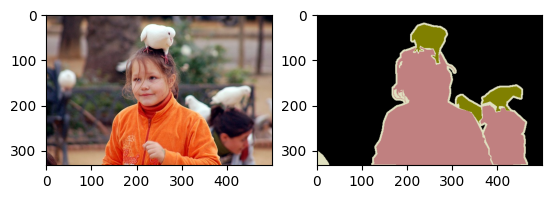

In [10]:
trainvalset_raw = VOCSegmentation(DATA_ROOT, VOC_YEAR, "trainval", download=False)

image, mask = trainvalset_raw[random.randint(0, len(trainvalset_raw) - 1)]
print("Mask values:", set(np.array(mask).flatten().tolist()))

fig, axs = plt.subplots(1, 2)
axs[0].imshow(image)
axs[1].imshow(mask)
plt.show()

In [33]:
class Scaler(object):
    """Отмасштабировать изображения сохранив пропорции.

    Пустые места будут заполнены отражениями.

    Аргументы:
        image: Изображение в HWC формате.
        size: Требуемый размер, пара W, H.
    """
    def __init__(self, size):
        self._size = size
        self._padding = 0

    def set_padding(self, padding):
        self._padding = padding

    def __call__(self, image):
        if not isinstance(image, np.ndarray):
            image = np.array(image)
        grayscale = (len(image.shape) == 2)
        if grayscale:
            image = image[..., None]
        rw, rh = self._size
        p = self._padding
        h, w, c = image.shape
        scale_x = rw / w
        scale_y = rh / h
        scale = min(scale_x, scale_y)
        sw = int(scale * w)
        sh = int(scale * h)
        offset_x = p + (rw - sw) // 2
        offset_y = p + (rh - sh) // 2
        # Используем zeros на случай маленьких изображений.
        result = np.zeros((rh + 2 * p, rw + 2 * p, c), dtype=image.dtype)
        cv2.resize(image, (sw, sh),
                   interpolation=cv2.INTER_NEAREST if grayscale else cv2.INTER_AREA,
                   dst=result[offset_y:offset_y + sh, offset_x:offset_x + sw])

        # Отразить.
        result[offset_y:offset_y + sh, :offset_x] = result[offset_y:offset_y + sh, offset_x:2 * offset_x][:, ::-1]
        offset_end = result.shape[1] - offset_x - sw
        result[offset_y:offset_y + sh, offset_x + sw:] = result[offset_y:offset_y + sh, sw + offset_x - offset_end:sw + offset_x][:, ::-1]

        result[:offset_y] = result[offset_y:2 * offset_y][::-1]
        offset_end = result.shape[0] - offset_y - sh
        result[offset_y + sh:] = result[sh + offset_y - offset_end:sh + offset_y][::-1]

        if grayscale:
            result = result[:, :, 0]
        return result


def remove_borders_inplace(mask):
    mask[mask == 255] = 0
    return mask


class VOCDataset(torch.utils.data.Dataset):
    """Обертка для стандартного класса, которая форматирует данные."""
    def __init__(self, root, year, image_size,
                 multiclass=MULTICLASS,
                 download=False, augment=False,
                 train=False, train_fraction=0.8,
                 padding=0):
        """Создать корпус.

        Аргументы:
            root: Путь до папки для хранения данных.
            year: 2007 или 2012.
            image_size: Ширина и высота изображений.
            download: Скачать корпус, если он не найден в папке.
            augment: Применить аугментации.
            train: Выделить train часть, иначе validation.
            train_fraction: Доля тренировочных примеров.
            padding: Добавить дополнительный зеркальынй паддинг к изображению.
        """
        self._dataset = VOCSegmentation(root, str(year), "trainval", download=download)
        self._image_size = np.array(image_size)
        self._multiclass = multiclass
        self._padding = padding

        ids = list(range(len(self._dataset)))
        random.seed(0)
        random.shuffle(ids)
        train_size = int(len(ids) * train_fraction)
        self._indices = ids[:train_size] if train else ids[train_size:]

        self._image_scaler = Scaler(image_size)
        self._mask_scaler = Scaler(image_size)
        if augment:
            self._augmenter = RandomAugmentation(
                                                ElasticTransform(),
                                                ToGray(),
                                                InvertImg(),
                                                AffineAugmenter(),
                                                BrightnessContrastAugmenter(),
                                                BlurAugmenter(),
                                                FlipAugmenter()
                                                )
        else:
            self._augmenter = lambda image, mask: (image, mask)

    @property
    def image_size(self):
        return self._image_size + self._padding * 2

    def set_padding(self, padding):
        self._padding = padding
        self._image_scaler.set_padding(padding)
        self._mask_scaler.set_padding(padding)

    def __len__(self):
        return len(self._indices)

    def __getitem__(self, idx):
        image, mask = self._dataset[self._indices[idx]]
        image = np.asarray(image)
        mask = np.array(mask)
        remove_borders_inplace(mask)
        if not self._multiclass:
            mask[mask > 0] = 1
        image = self._image_scaler(image)
        mask = self._mask_scaler(mask)
        image, mask = self._augmenter(image, mask)
        image = cvmade.image.image_to_torch(image).float() - 0.5
        mask = cvmade.image.image_to_torch(mask[..., None]).long()[0]
        return image, mask

IMAGE_SIZE = 512  # В исходной статье U-Net применяется к изображениям размера 572.

# Корпус был загружен выше, download = False.
trainset = VOCDataset(DATA_ROOT, VOC_YEAR, (IMAGE_SIZE, IMAGE_SIZE),
                      multiclass=MULTICLASS, train=True)
valset = VOCDataset(DATA_ROOT, VOC_YEAR, (IMAGE_SIZE, IMAGE_SIZE),
                    multiclass=MULTICLASS, train=False)
print("Image size:", IMAGE_SIZE)
print("Train set size:", len(trainset))
print("Validation set size:", len(valset))

Image size: 512
Train set size: 2330
Validation set size: 583


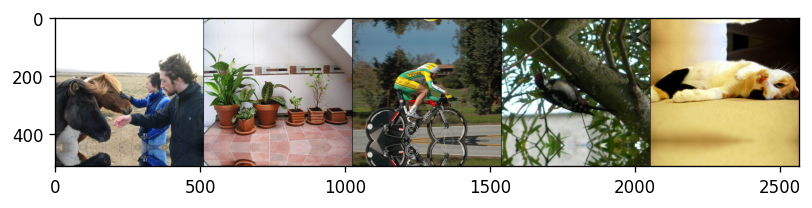

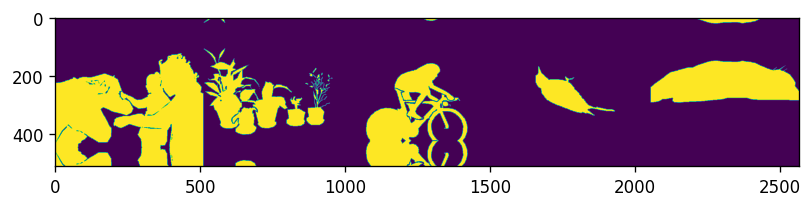

In [12]:
def show_dataset(dataset):
    images = []
    masks = []
    for _ in range(5):
        i = random.randint(0, len(valset) - 1)
        if len(images):
            separator = np.zeros((dataset.image_size[0], 2, 3), dtype=np.uint8)
            images.append(separator)
            masks.append(separator[:, :, 0])
        image, mask = dataset[i]
        images.append(cvmade.image.image_to_numpy(image))
        masks.append(cvmade.image.image_to_numpy(mask[None, ...])[..., 0])

    %matplotlib inline
    set_figure_size()
    plt.imshow(np.concatenate(images, axis=1))
    plt.show()
    set_figure_size()
    plt.imshow(np.concatenate(masks, axis=1))
    plt.show()

valset.set_padding(0)
show_dataset(trainset)

## Загрузка модели
Я попробую обучить модель U-Net++ из https://github.com/qubvel/segmentation_models.pytorch#examples

In [13]:
import segmentation_models_pytorch as smp

In [27]:
unet = smp.UnetPlusPlus(encoder_name='resnet34',
                        encoder_weights=None,
                        classes=1,
                        encoder_depth=5,
                       )

def count_parameters(model):
    total = 0
    for p in model.parameters():
        total += np.prod(list(p.shape))
    return total

In [15]:
print(unet)
print("Total parameters: {}".format(count_parameters(unet)))

UnetPlusPlus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=Tru

## Обучение

Создадим класс для подсчета функции потерь - бинарной перекрестной энтропии.

In [16]:
def crop_images(predicted, masks_or_images):
    """Если выход больше или меньше чем исходное изображение,
    вырезать центральную часть из обоих, чтобы размеры совпадали.
    """
    if len(masks_or_images.shape) == 3:
        predicted, masks = crop_images(predicted, masks_or_images.unsqueeze(1))
        return predicted, masks[:, 0]
    images = masks_or_images
    if (len(predicted.shape) != 4) or (len(images.shape) != 4):
        raise ValueError("Expected tensors of shape BCHW")
    bi, ci, hi, wi = images.shape
    bp, cp, hp, wp = predicted.shape
    offset = (abs(hi - hp) // 2, abs(wi - wp) // 2)
    if hp < hi:
        images = images[:, :, offset[0]:offset[0] + hp]
    else:
        predicted = predicted[:, :, offset[0]:offset[0] + hi]
    if wp < wi:
        images = images[:, :, :, offset[1]:offset[1] + wp]
    else:
        predicted = predicted[:, :, :, offset[1]:offset[1] + wi]
    return predicted, images

In [17]:
class BCELoss(torch.nn.Module):
    def __init__(self):
        super().__init__()

        # Ваш код здесь.

        self._bce = torch.nn.BCEWithLogitsLoss()

        # Конец вашего кода.

    def __call__(self, predicted, masks):
        predicted, masks = crop_images(predicted, masks)
        b, c, h, w = predicted.shape
        if c != 1:
            raise ValueError("{} не подходит для многоклассовой классификации".format(type(self)))

        # predicted: float32, BCHW.
        # masks: long, BHW.

        # Ваш код здесь.

        loss = self._bce(predicted.squeeze(1), masks.float())

        # Конец вашего кода.

        return loss

seminar.check_bce_loss(BCELoss)
seminar.check_ok()

CHECK OK


# 3. Другой лосс (DICE-loss)
Надо реализовать следующую формулу, и ее результат прибавить к BCE:

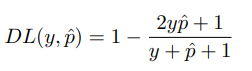

In [18]:
class DiceBCELoss(torch.nn.Module):
    def __init__(self):
        super().__init__()

        # Ваш код здесь.

        self._bce = torch.nn.BCEWithLogitsLoss()

        # Конец вашего кода.

    def __call__(self, predicted, masks, smooth=1):
        predicted, masks = crop_images(predicted, masks)
        b, c, h, w = predicted.shape
        if c != 1:
            raise ValueError("{} не подходит для многоклассовой классификации".format(type(self)))

        # predicted: float32, BCHW.
        # masks: long, BHW.

        # Ваш код здесь.

        inputs = predicted.squeeze(1)
        targets = masks.float()
        bce_loss = self._bce(inputs, targets)
        intersection = (inputs * targets).sum()
        dice_loss = 1 - (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)
        Dice_BCE = bce_loss + dice_loss

        # Конец вашего кода.

        return Dice_BCE

In [19]:
class XentLoss(torch.nn.Module):
    """Функция потерь для сегментации с несколькими классами."""
    def __init__(self):
        super().__init__()
        self._xent = torch.nn.CrossEntropyLoss()

    def __call__(self, predicted, masks):
        predicted, masks = crop_images(predicted, masks)
        b, c, h, w = predicted.shape
        if c == 1:
            raise ValueError("{} не подходит для бинарной классификации".format(type(self)))
        predicted = predicted.permute(0, 2, 3, 1).reshape(b * h * w, c)
        masks = masks.reshape(-1)
        loss = self._xent(predicted, masks)
        return loss

In [20]:
def make_optimizer(model):
    return torch.optim.Adam(model.parameters(), lr=1e-4)

# 2. Метрика для валидации
В качестве метрики берется Mean-IoU (в pytorch соответствующий метод называется BinaryJaccardIndex)

In [28]:
import torchmetrics
metric_fn = torchmetrics.classification.BinaryJaccardIndex()

In [29]:
loss_fn = DiceBCELoss if NUM_CLASSES == 2 else XentLoss


if TRAIN:
    # trainset.set_padding(unet.padding)
    # valset.set_padding(unet.padding)
    seminar.train_model(unet, loss_fn, metric_fn, make_optimizer, trainset, valset,
                        lr_scheduler_fn=lambda opt: None,
                        eval_steps=500,
                        batch_size=4,
                        num_epochs=3)
else:
    unet.load_state_dict(torch.load("checkpoint-noaug.pth.tar", map_location=DEVICE))
    cvmade.plot.show_image("resources/00-1-noaug.jpg")
    cvmade.plot.show_image("resources/00-2-noaug.jpg")
    cvmade.plot.show_image("resources/00-3-noaug.jpg")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type               | Params
--------------------------------------------------
0 | _model     | UnetPlusPlus       | 26.1 M
1 | _metric_fn | BinaryJaccardIndex | 0     
2 | _criterion | DiceBCELoss        | 0     
--------------------------------------------------
26.1 M    Trainable params
0         Non-trainable params
26.1 M    Total params
104.314   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=3` reached.


In [95]:
torch.save(unet.state_dict(), "checkpoint-noaug.pth.tar")

In [23]:
%load_ext tensorboard
%tensorboard --logdir ./lightning_logs

<IPython.core.display.Javascript object>

# Сравнение BCE и DiceBCE (скрин из tensorboard)
Зеленый - BCE

Красный - DiceBCE
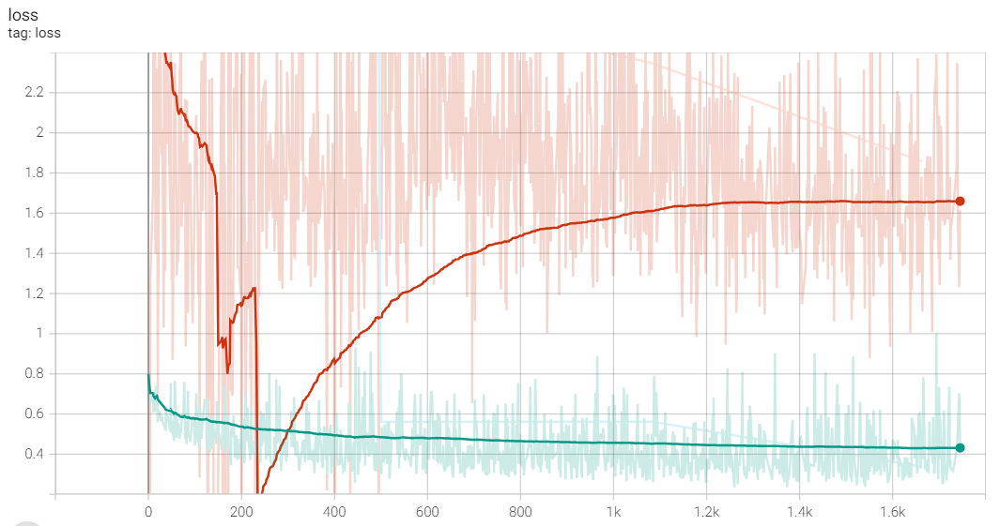

Второй лосс больше, но это происходит из-за того, что по сути он представляет из себя сумму двух величин - BCE и Dice.

# Гораздно важнее показатель метрики

Mean-IoU для второго лосса (красный) растет лучше

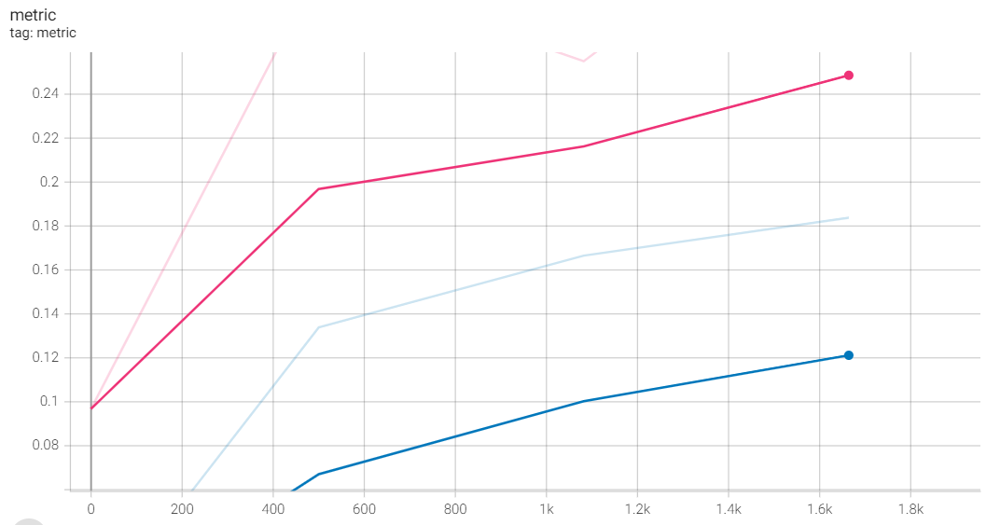

# Результат сегментации после трех эпох

# Show segmentation


In [30]:
def show_segmentations(model, dataset, n=5):
    model.eval()
    if USE_CUDA:
        model.cuda()
    for _ in range(n):
        image, mask_gt = dataset[random.randint(0, len(dataset) - 1)]
        if USE_CUDA:
            image = image.cuda()
            mask_gt = mask_gt.cuda()
        with torch.no_grad():
            predicted = model(image.unsqueeze(0))[0]  # CHW.
            predicted, image = crop_images(predicted.unsqueeze(0), image.unsqueeze(0))
            predicted, image = predicted[0], image[0]
            c = predicted.shape[0]
            if c == 1:
                predicted = torch.nn.functional.logsigmoid(predicted)
                aggregated = predicted[0]
                predicted_labels = predicted[0] > np.log(0.5)
            else:
                predicted = torch.nn.functional.log_softmax(predicted, 0)
                aggregated = torch.logsumexp(predicted[1:], axis=0)
                predicted_labels = predicted.max(0)[1]
        aggregated = aggregated.cpu().numpy()
        predicted_labels = predicted_labels.cpu().numpy().astype(np.uint8)
        image = cvmade.image.image_to_numpy(image)
        mask = (predicted_labels > 0)[..., None]
        selected = image * mask + 255 * (1 - mask)

        %matplotlib inline
        if c != 1:
            print("Classes:", [LABELS[i] for i in set(predicted_labels.flatten().tolist())])
        set_figure_size()
        fig, axs = plt.subplots(1, 4, figsize=(12, 6))
        axs[0].imshow(image)
        axs[1].imshow(predicted_labels)
        axs[2].imshow(aggregated)
        axs[3].imshow(selected)
        plt.show()

Trainset


<Figure size 960x720 with 0 Axes>

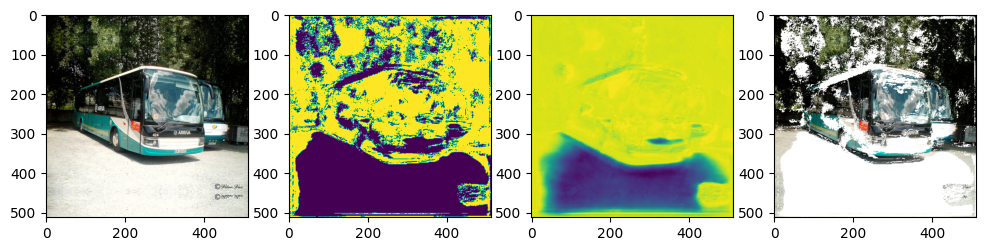

<Figure size 960x720 with 0 Axes>

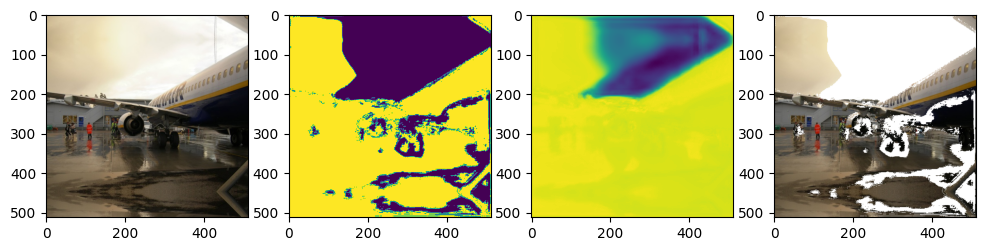

<Figure size 960x720 with 0 Axes>

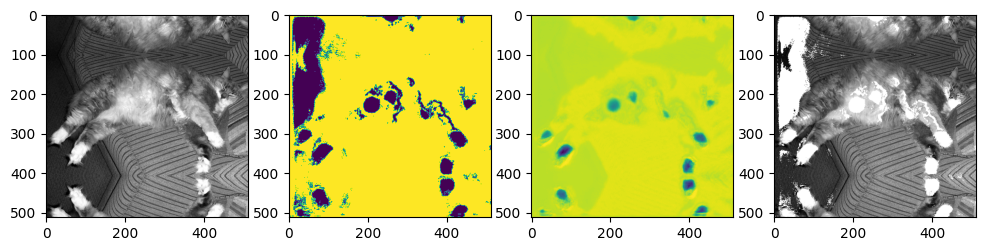

<Figure size 960x720 with 0 Axes>

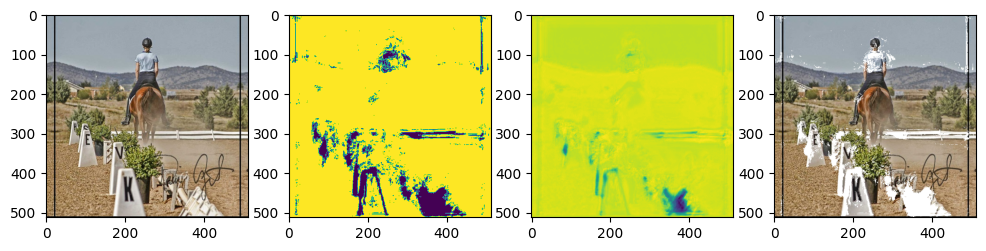

<Figure size 960x720 with 0 Axes>

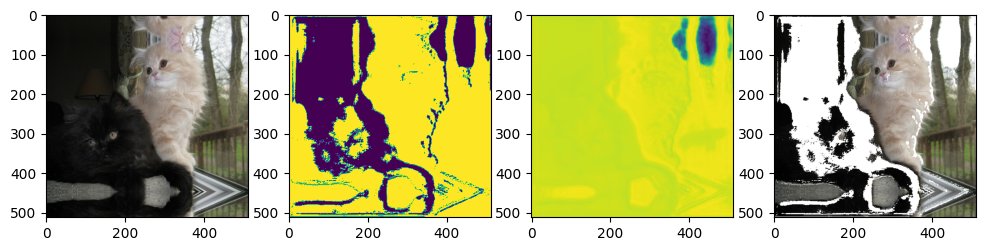

Valset


<Figure size 960x720 with 0 Axes>

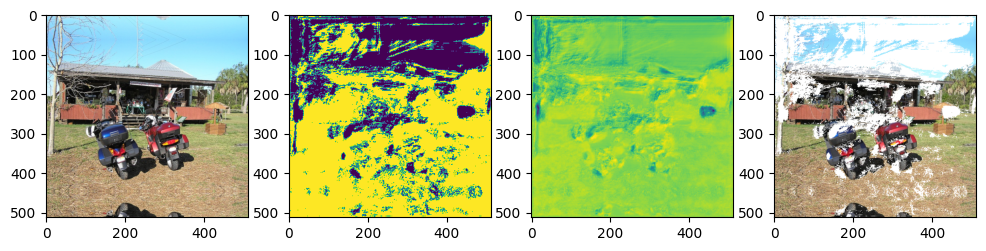

<Figure size 960x720 with 0 Axes>

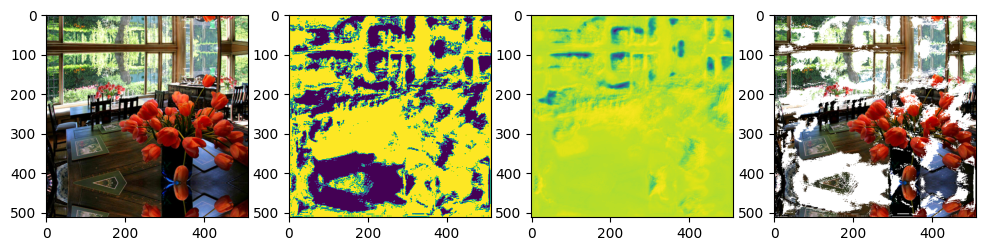

<Figure size 960x720 with 0 Axes>

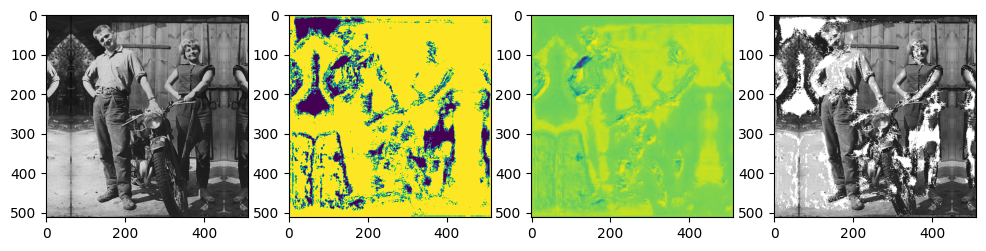

<Figure size 960x720 with 0 Axes>

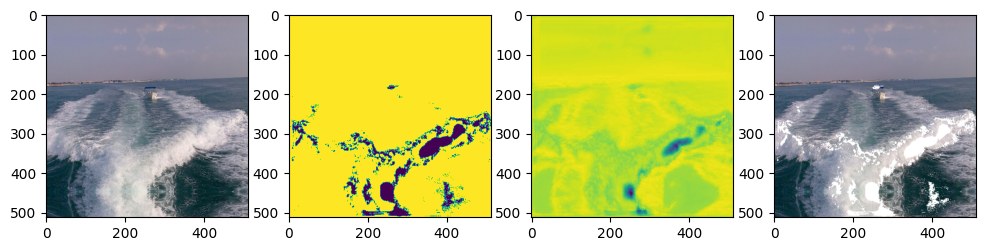

<Figure size 960x720 with 0 Axes>

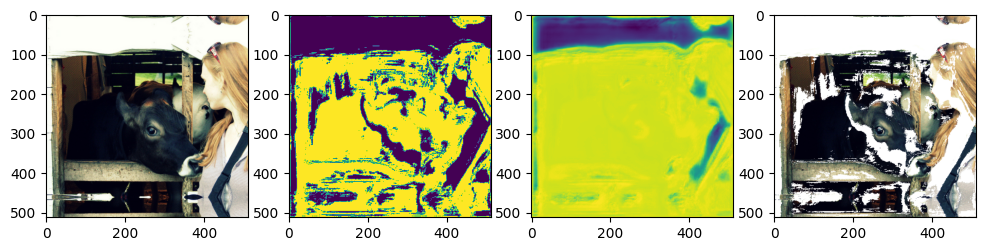

In [31]:
print("Trainset")
show_segmentations(unet, trainset)

print("Valset")
show_segmentations(unet, valset)

# Augmenation

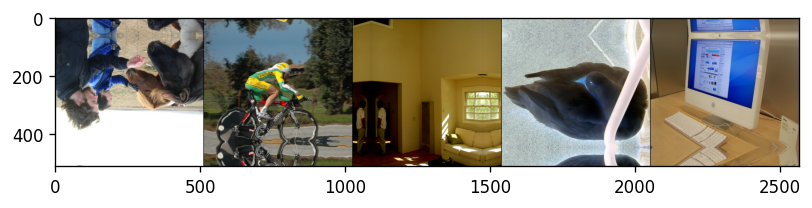

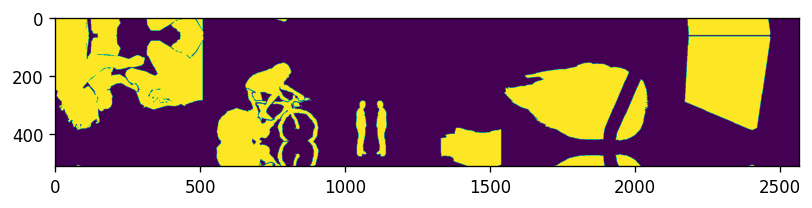

In [34]:
trainset_augmented = VOCDataset(DATA_ROOT, VOC_YEAR, (IMAGE_SIZE, IMAGE_SIZE),
                                multiclass=MULTICLASS, train=True, augment=True)
show_dataset(trainset_augmented)

In [38]:
loss_fn = DiceBCELoss if NUM_CLASSES == 2 else XentLoss

if TRAIN:
    # Разрешить интерактивные графики.
    # trainset.set_padding(unet.padding)
    # valset.set_padding(unet.padding)
    seminar.train_model(unet, loss_fn, metric_fn, make_optimizer, trainset_augmented, valset,
                        lr_scheduler_fn=lambda optimizer: None,
                        eval_steps=500,
                        batch_size=4,
                        num_epochs=5
                        )
    # Отключить интерактивные графики.
else:
    unet.load_state_dict(torch.load("checkpoint-aug.pth.tar", map_location=DEVICE))
    cvmade.plot.show_image("resources/01-1-aug.jpg")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type               | Params
--------------------------------------------------
0 | _model     | UnetPlusPlus       | 26.1 M
1 | _metric_fn | BinaryJaccardIndex | 0     
2 | _criterion | DiceBCELoss        | 0     
--------------------------------------------------
26.1 M    Trainable params
0         Non-trainable params
26.1 M    Total params
104.314   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=5` reached.


In [ ]:
#torch.save(unet.state_dict(), "checkpoint-aug.pth.tar")

In [39]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

# Сравнение лоссов с аугментациями и без
6-я версия обозначает обучение с аугментациями. Модель обучалась 5 эпох и, как видно, у нее еще есть неплохой потенциал
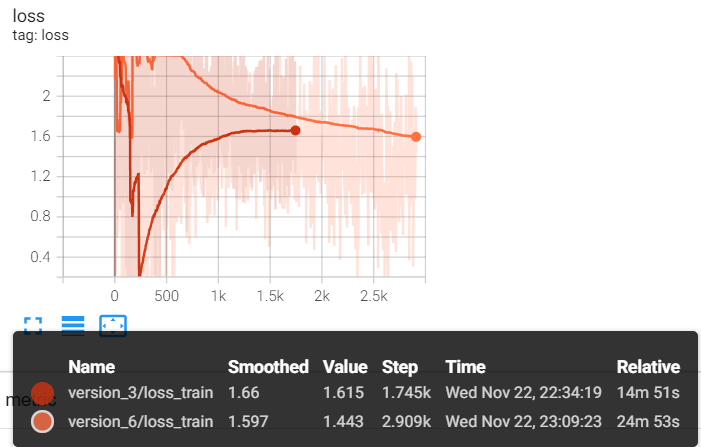

# Сравнение метрик
Mean-IoU тоже выше, однако он начинает выходить на плато. В таком случае, возможно, сделаны слишком сильные аугментации, которые значительно расходятся с валидационными
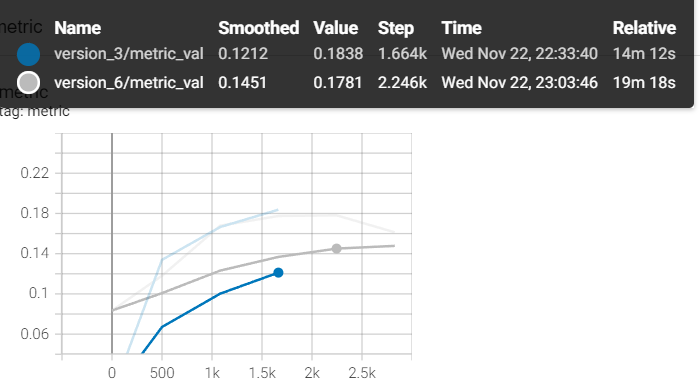